In [275]:
import pandas as pd
import numpy as np

In [400]:
data = pd.read_csv('melb.csv')

In [401]:
data.dropna(subset=['address','price'],inplace=True)

# First start with numeric columns

def clean_numbers(col):
    """
    Turn str into float and turn into None numbers below 10.
    """
    col = col.str.extract(r"(\d+)")[0]
    col = col.apply(lambda x: float(x) if x is not np.nan else x)
    col = col.apply(lambda x: None if x > 10 else x)
    
    return col

data['price'] = data.price.apply(lambda x: x.replace("$",""))
data['price'] = data.price.apply(lambda x: float(x.replace(",","")))

data['views'] = data.views.str[0]
data['bathroom'] = clean_numbers(data.bathroom);
data['bedrooms'] = clean_numbers(data.bedrooms);


# Then date
def clean_date(col, today):
    """"
    Turn relative ('yesterday', 'hours ago') time into a standart date. 
    """
    col[col.str.contains("ago", na=False)] = today;
    col[col.str.contains("yesterday", na=False)] = (pd.to_datetime(today,format="%d/%m/%Y")-pd.Timedelta('1 days')).strftime('%d/%m/%Y');
    col[col.notnull()] = col[col.notnull()].apply(lambda x: None if len(x)!=12 else x);
    col[col.str.contains(r"\s", na=False)] = None;
    col = pd.to_datetime(col,format="%d/%m/%Y");

todays = u"17/11/2018"

data['availability'] = clean_date(data.availability, todays);
data['date_listed'] = clean_date(data.date_listed, todays);
data['date_update'] = clean_date(data.date_update, todays);

C:\Users\framo\AppData\Local\Temp\ipykernel_12900\887312164.py:22: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\framo\AppData\Local\Temp\ipykernel_12900\887312164.py:23: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\framo\AppData\Local\Temp\ipykernel_12900\887312164.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\framo\AppData\Local\Temp\ipykernel_12900\887312164.py:25: SettingWithCopyWarning:


A value

### Note on the data

- Clean non residential
- Clean monthly prices /quartern

In [278]:
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_rows', 300)

In [279]:
data = data[(data.price < 10000) & (data.price > 100)]

In [318]:
#data[data.text.str.contains('\d+\s?pcm|pm|p\/m', case=False)].text

In [369]:
pattern = 'monthly|[per|each|every|calendar|\/] month|\d+\s?pcm|pm|p\/m|lease [transfer|break|takeover]|[house|apartment|unit] for [rent|lease]'
view = data[data.text.str.contains(pattern, case=False)].text.str.extractall('([A-Za-z\s]+[\$\d]+[\d\.\,]*[A-Za-z\s\.]*)')
month_token = view.reset_index()[view.reset_index()[0].str.contains('month|\d+\s?pcm|pm|p\/m', case=False)]
month_token['next2token'] = month_token[0].str.extract('(\d*\,?\d+\.?\d*)')[0].str.replace(",","").astype(float)
month_token = month_token.reset_index().groupby('level_0').agg(list).reset_index().merge(data[['price','text']], left_on='level_0', right_index=True)
#month_token[month_token[['price','next2token']].apply(lambda x: x.price in x.next2token, axis=1)]
index2transform = month_token[month_token[['price','next2token']].apply(lambda x: x.price in x.next2token, axis=1)].level_0.tolist()

In [399]:
data[data.index.map(lambda x: x in index2transform)].price  = (data[data.index.map(lambda x: x in index2transform)].price * 12)/52 

C:\Users\framo\AppData\Local\Temp\ipykernel_12900\3972301596.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [213]:
data[(data.price > 1000) & data.text.str.contains(pattern, case=False)][['price', 'text']].shape

(134, 2)

In [4]:
data['neigh'] = data.link.str.split('/').str[4].str.replace("-"," ")#.value_counts()
data['for_couple'] = data.text.str.contains('couple', case=False, na= False) | data.title.str.contains('couple', case=False, na=False)

In [98]:
data.groupby('neigh').price.mean()
data[data.for_couple].groupby('neigh').price.mean()


neigh
airport west         600.0
ashwood              549.0
avondale heights     180.0
bayswater            365.0
blackburn north      200.0
                     ...  
wheelers hill        500.0
windsor              450.0
wollert              650.0
wyndham vale         415.0
yarraville          1300.0
Name: price, Length: 85, dtype: float64

In [99]:
import geopandas as gpd

geo_df = gpd.read_file('VIC_LOCALITY_POLYGON_shp GDA2020\VIC_LOCALITY_POLYGON_shp.shx')


In [100]:
geo_df['neigh'] = geo_df.VIC_LOCA_2.str.lower()#
lista1 = geo_df.neigh.unique().tolist()
lista2 = data.neigh.tolist()
list(set(lista2) - set(lista1))

['nillumbik area']

In [101]:
data.neigh = data.neigh.str.replace('rosebud west', 'rosebud')
data.neigh = data.neigh.str.replace('melbourne cbd', 'melbourne')

In [13]:
data[data.neigh == 'nillumbik area']

,address,availability,bathroom,bedrooms,date_listed,date_update,furnished,gender,link,parking,pet,price,smoking,text,title,type_,user,views,neigh,for_couple
871,"Nillumbik Area, VIC",None,2.0,4.0,None,None,Yes,NaN,https://www.gumtree.com.au/s-ad/nillumbik-area...,LUG,No,390.0,No,House for rent beautiful 4bedroom new house bu...,House for rent,House,"vee,Gummie since, ,2012",3,nillumbik area,False


In [26]:
#geo_df.to_file("melb.geojson", driver='GeoJSON')
#melb = gpd.read_file('melb.geojson')

In [102]:
summ = data.groupby('neigh', as_index= False).price.agg(['mean','count'])
summ.reset_index(inplace=True)
geo_df.geometry = geo_df.geometry.to_crs(epsg='4326')
tt = geo_df.merge(summ, how='inner', on='neigh')

In [103]:
summ[summ.neigh.str.contains('melbourne')]

,neigh,mean,count
81,east melbourne,1516.666667,3
148,melbourne,631.689189,111
172,north melbourne,553.375000,16
188,port melbourne,1114.000000,2
238,west melbourne,716.000000,5


<AxesSubplot: >

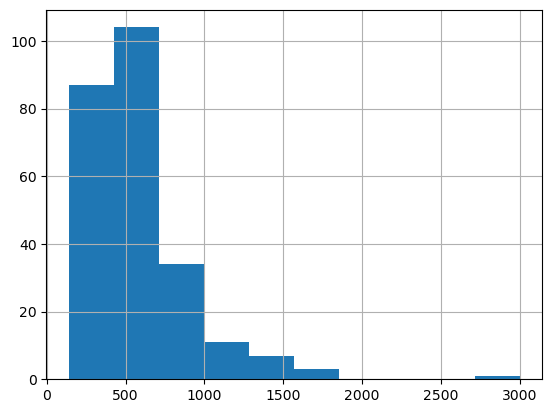

In [104]:
tt['mean'].hist()

In [105]:
np.log(tt['mean'])

0      6.214608
1      5.521461
2      5.757850
3      5.491002
4      6.263398
         ...   
242    6.354370
243    6.520621
244    5.913503
245    8.006368
246    6.351584
Name: mean, Length: 247, dtype: float64

In [106]:
import plotly.express as px

px.choropleth_mapbox(tt, geojson= tt.geometry, locations= tt.index, color=np.log(tt['mean']),
                           mapbox_style="stamen-toner", hover_name = 'neigh', opacity = 0.6, center= {'lat':-37.8097305,'lon':144.9039946})


## Investigate how to extract prices for couples

In [52]:
data[data.for_couple][['text','price']].iloc[2].text

'Hi,Room available for couple or single close to tarniet station,$700 per month for couple/$450 for single,Contact-******0922'

In [115]:
data[data.for_couple].text.str.extractall('(\$\d{3,4})[\w\s\.,:]*(couples)')

0        1
   match               
14 0      $290  couples
   1      $290  couples

In [29]:
data.head(3)

,address,availability,bathroom,bedrooms,date_listed,date_update,furnished,gender,link,parking,pet,price,smoking,text,title,type_,user,views,neigh
0,"2/19B David Street, Carlton VIC 3053",None,1.0,NaN,None,None,Yes,NaN,https://www.gumtree.com.au/s-ad/carlton/proper...,Street,No,340.00,No,This wonderfull 6 year old fully furnished bed...,Fully Furnished. All bills included. 3 month m...,Apartment & Unit,"Nick,Gummie since, ,2008",2,carlton
1,"101 Clarendon Street, Southbank VIC",None,2.0,2.0,None,None,Yes,NaN,https://www.gumtree.com.au/s-ad/southbank/prop...,LUG,Yes,400.00,Yes,"The property is centrally located, close to re...",A Spacious & Comfy 2BR Suite in Southbank,Apartment & Unit,"Riley,Gummie since, ,2019",1,southbank
2,Abbotsford VIC,None,1.0,1.0,None,None,Yes,NaN,https://www.gumtree.com.au/s-ad/abbotsford/pro...,Street,Yes,405.25,No,405.25AUD$/week (1621AUD$/month) bills ( /- 80...,Apartment for rent,Apartment & Unit,"Mathias,5, ,ads,Gummie since, ,2019",8,abbotsford
